In [2]:
# Link to the challenge : https://www.aapm.org/grandchallenge/lowdosect/

In [3]:
low_dose_ct_training_dataset_dir = '../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data'
low_dose_ct_testing_dataset_dir = '../../../Dataset/LowDoseCTGrandChallenge/Testing_Image_Data'

In [4]:

import os
import numpy as np
import cv2 as cv
import tensorflow as tf
from glob import glob
import matplotlib.pylab as plt
import nibabel as nibfrom 
from PIL import Image
import pydicom

In [5]:
training_filepaths_x = []   # i.e the QD (quarter dose) images (noisy images)
training_filepaths_y = []   # i.e the FD (full dose) images (clean images)

for root, folder_name, file_names in os.walk(low_dose_ct_training_dataset_dir):
    for file_name in file_names:
        file_path = os.path.join(root, file_name)
        
        if "QD" in file_name:
            training_filepaths_x.append(file_path)
        elif "FD" in file_name:
            training_filepaths_y.append(file_path)
            
training_filepaths_x.sort()
training_filepaths_y.sort()

In [6]:
print('[Training] number of noisy images (QD) : ', len(training_filepaths_x))
print('[Training] number of clean images (FD) : ', len(training_filepaths_y))

[Training] number of noisy images (QD) :  16628
[Training] number of clean images (FD) :  16628


In [7]:
testing_filepaths_x = []   # i.e the QD (quarter dose) images (noisy images)
testing_filepaths_y = []   # i.e the FD (full dose) images (clean images)

for root, folder_name, file_names in os.walk(low_dose_ct_testing_dataset_dir):
    for file_name in file_names:
        file_path = os.path.join(root, file_name)
        
        if "QD" in file_name:
            testing_filepaths_x.append(file_path)
        elif "FD" in file_name:
            testing_filepaths_y.append(file_path)
            
testing_filepaths_x.sort()
testing_filepaths_y.sort()

In [8]:
print('[Testing] number of noisy images (QD) : ', len(testing_filepaths_x))
print('[Testing] number of clean images (FD) : ', len(testing_filepaths_y))

[Testing] number of noisy images (QD) :  20938
[Testing] number of clean images (FD) :  0


In [9]:
# Visualization of few image pairs (noisy and clean)

print(training_filepaths_x[0], '\n', training_filepaths_y[0])

../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data\1mm B30\QD_1mm\quarter_1mm\L067\quarter_1mm\L067_QD_1_1.CT.0003.0001.2015.12.22.18.10.55.420810.358276339.IMA 
 ../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data\1mm B30\FD_1mm\full_1mm\L067\full_1mm\L067_FD_1_1.CT.0001.0001.2015.12.22.18.09.40.840353.358074219.IMA


In [10]:
def read_image(image_path):
    data = pydicom.dcmread(image_path)
    return data.pixel_array

(512, 512)
(512, 512)


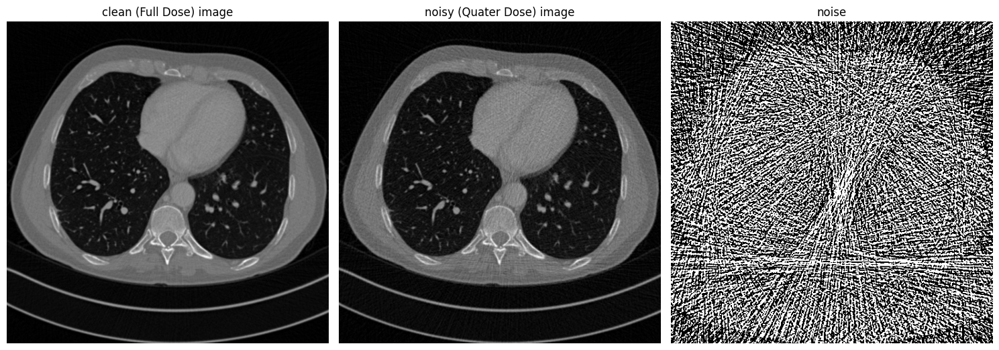

(512, 512)
(512, 512)


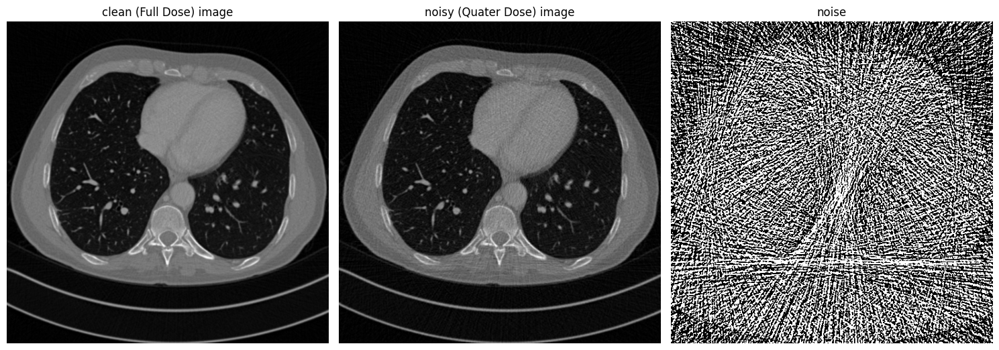

(512, 512)
(512, 512)


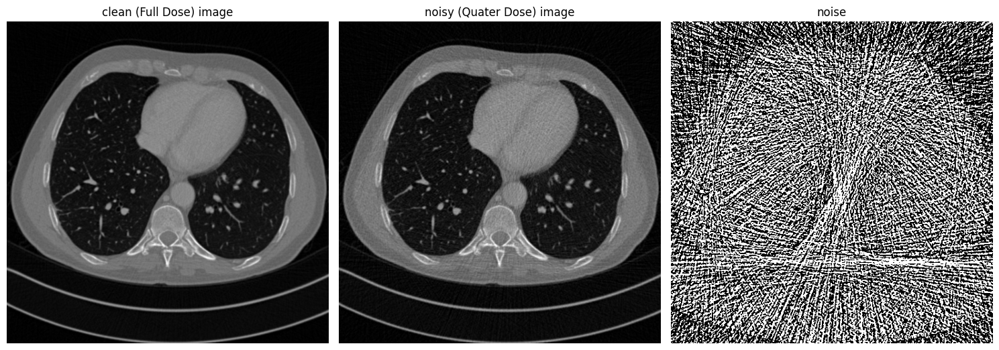

(512, 512)
(512, 512)


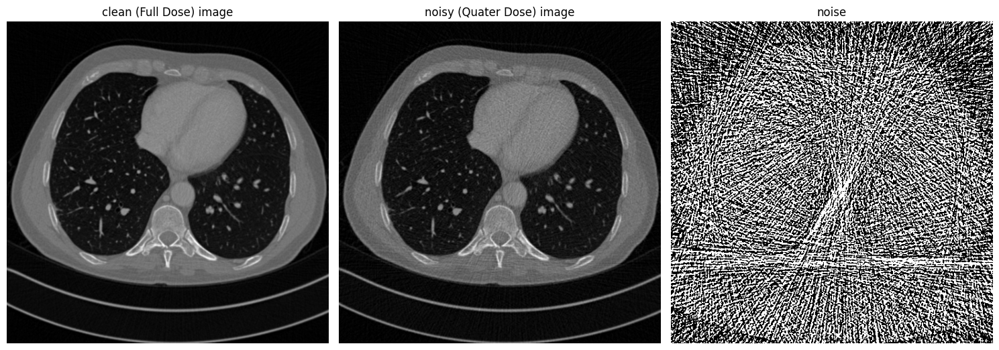

(512, 512)
(512, 512)


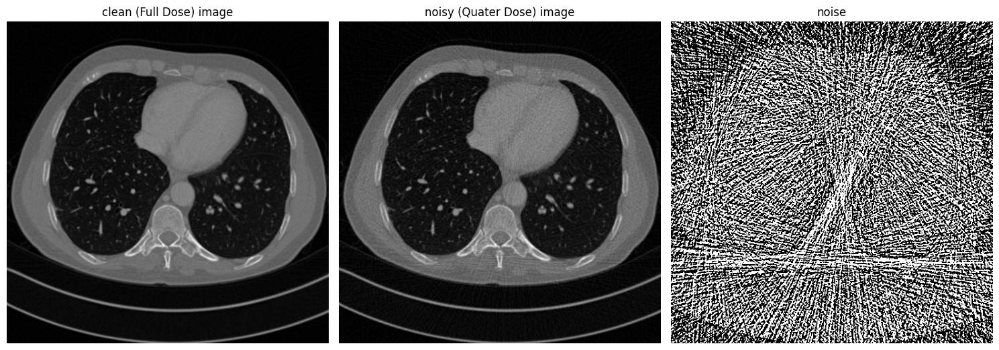

(512, 512)
(512, 512)


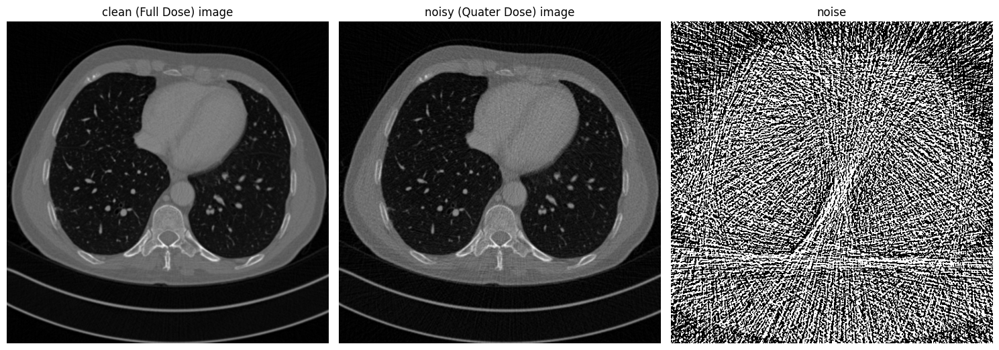

(512, 512)
(512, 512)


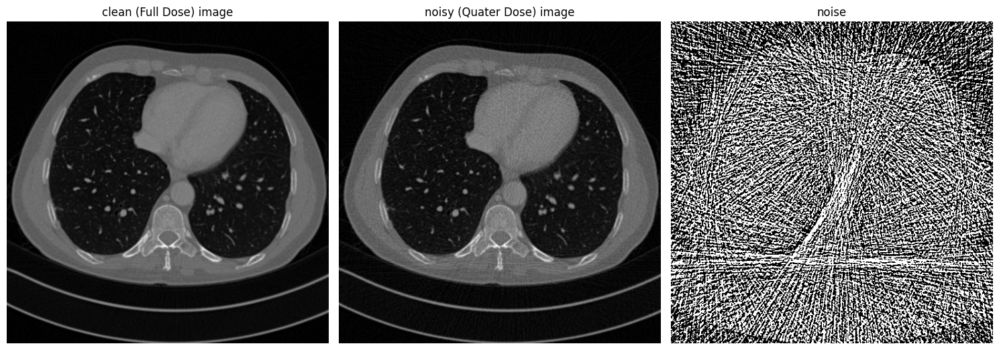

(512, 512)
(512, 512)


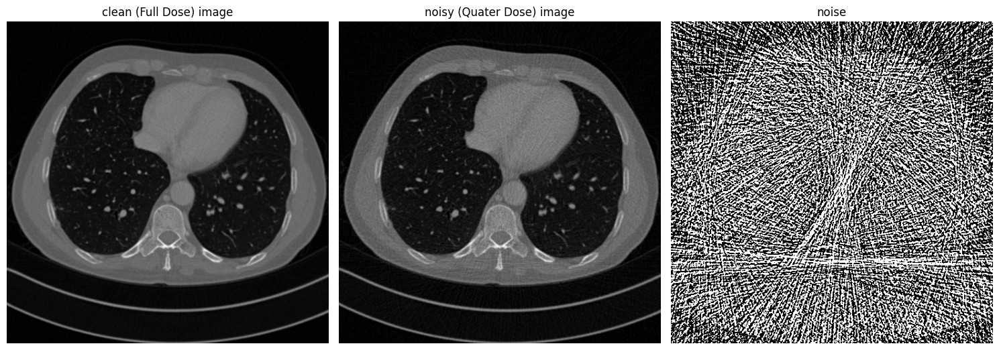

(512, 512)
(512, 512)


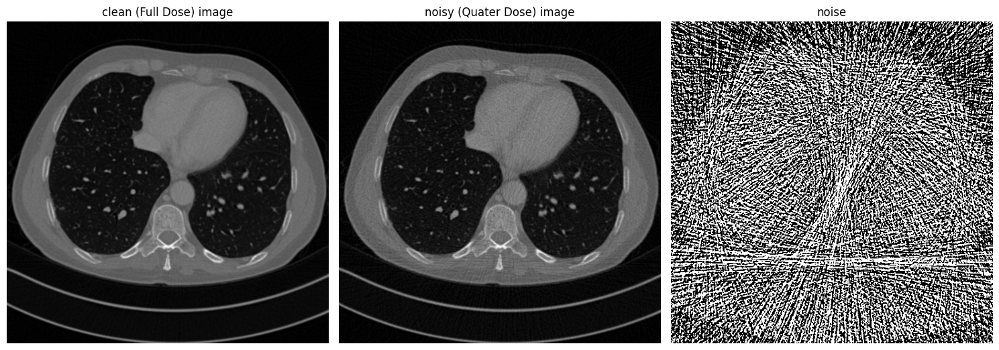

(512, 512)
(512, 512)


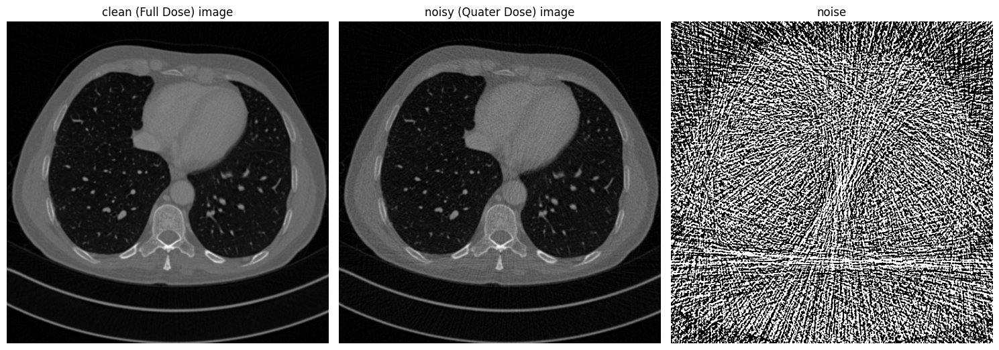

In [11]:
for i in range(0, 10):
    noisy_image = read_image(training_filepaths_x[i])
    clean_image = read_image(training_filepaths_y[i])
    
    print(noisy_image.shape)
    print(clean_image.shape)
    
    fig, axs = plt.subplots(1, 3, figsize=(15, 8))
    
    axs[0].set_title('clean (Full Dose) image')
    axs[0].imshow(clean_image, cmap='gray')
    axs[0].axis('off')  # Turn off axis labels
    
    axs[1].set_title('noisy (Quater Dose) image')
    axs[1].imshow(noisy_image, cmap='gray')
    axs[1].axis('off')  # Turn off axis labels
    
    axs[2].set_title('noise')
    axs[2].imshow(noisy_image - clean_image, cmap='gray')
    axs[2].axis('off')  # Turn off axis labels
    
    plt.tight_layout()
    
    plt.show()

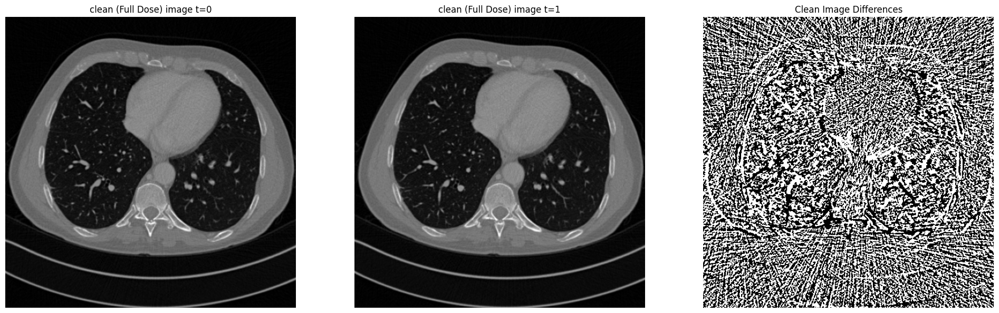

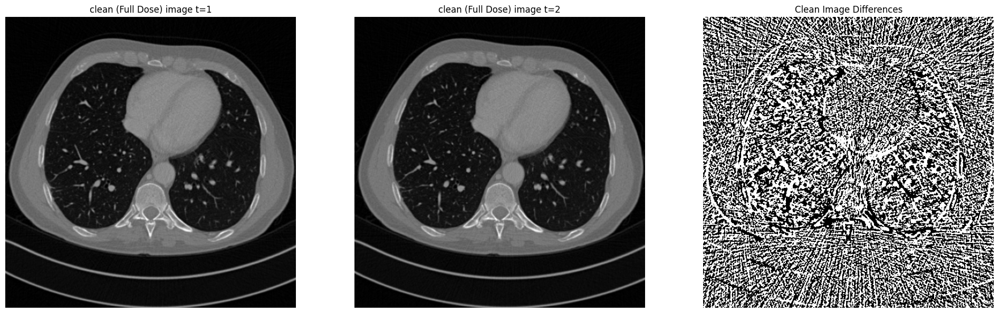

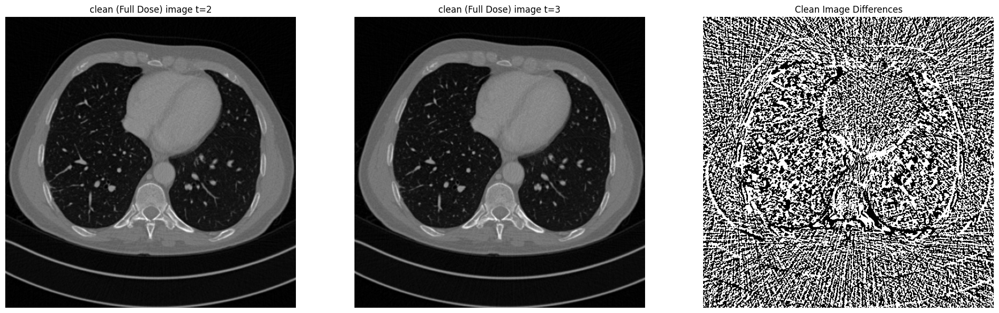

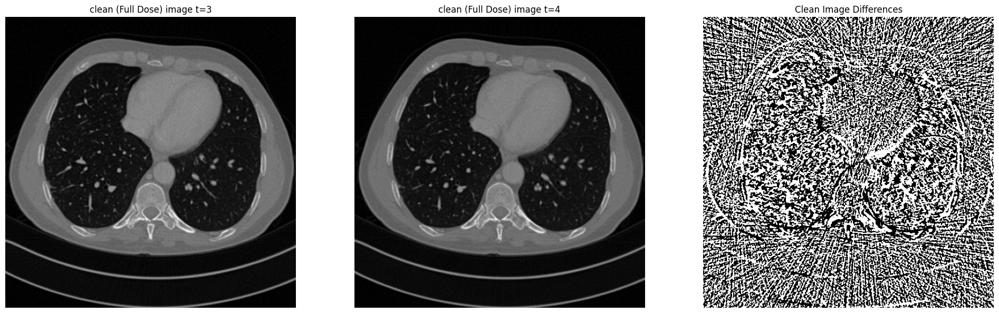

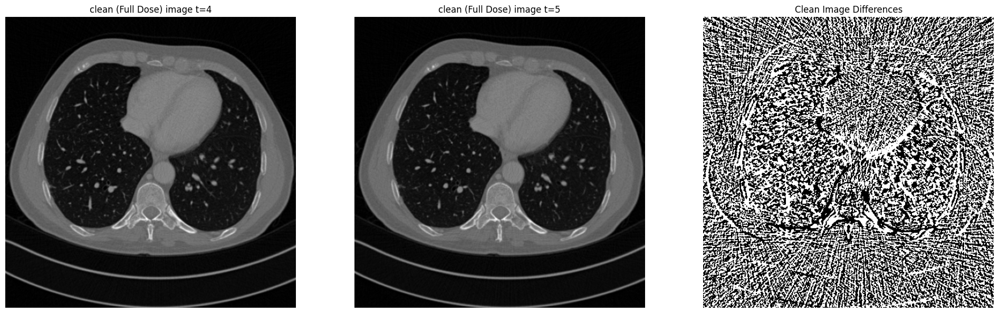

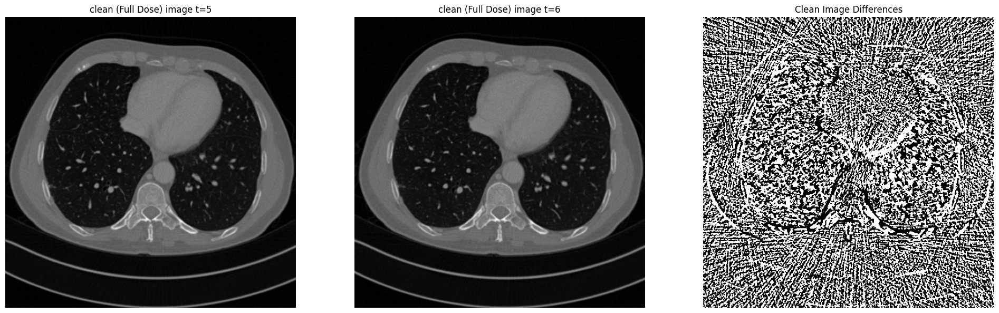

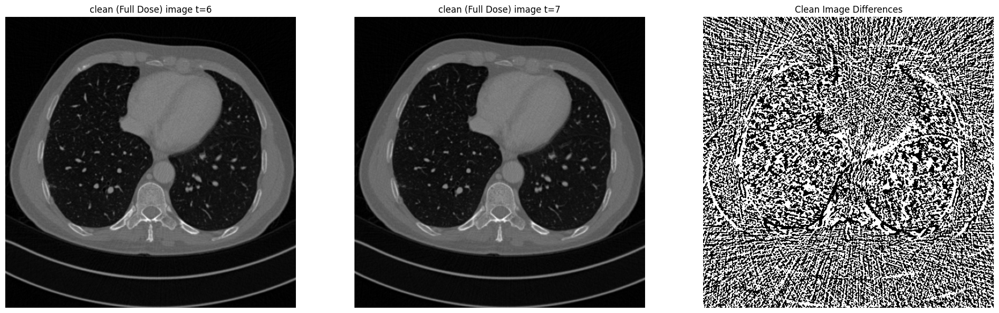

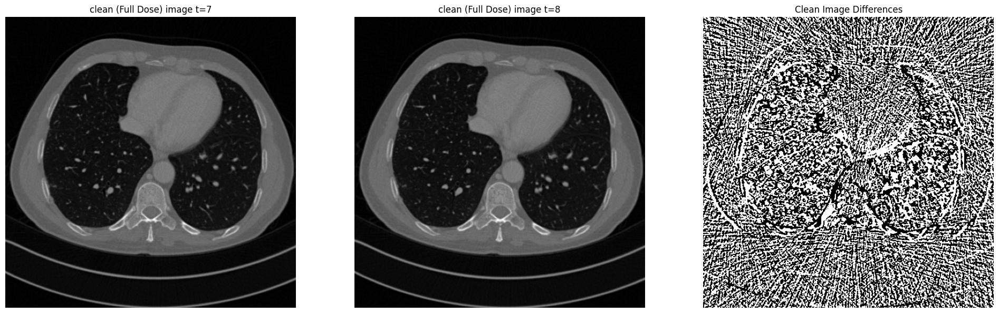

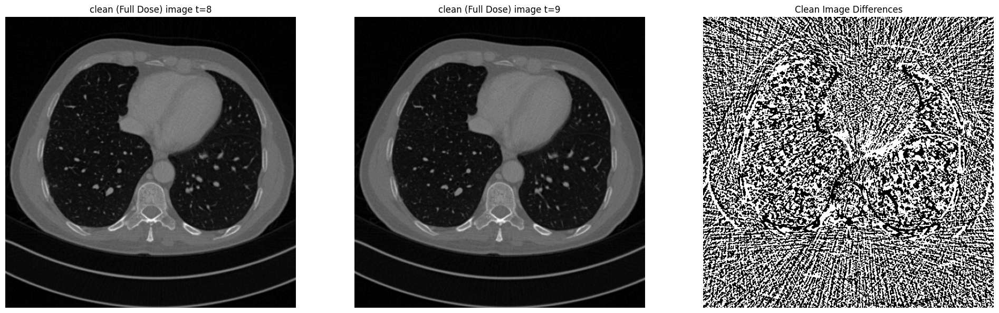

In [12]:
for i in range(9):
    noisy_image_0 = read_image(training_filepaths_x[i])
    clean_image_0 = read_image(training_filepaths_y[i])
    
    noisy_image_1 = read_image(training_filepaths_x[i + 1])
    clean_image_1 = read_image(training_filepaths_y[i + 1])
    
    fig, axs = plt.subplots(1, 3, figsize=(20, 6))  # Adjust figsize as needed
    
    # Display clean_image_0
    axs[0].set_title('clean (Full Dose) image t=' + str(i))
    axs[0].imshow(clean_image_0, cmap='gray')
    axs[0].axis('off')  # Turn off axis labels
    
    # Display clean_image_1
    axs[1].set_title('clean (Full Dose) image t=' + str(i + 1))
    axs[1].imshow(clean_image_1, cmap='gray')
    axs[1].axis('off')  # Turn off axis labels
    
    # Display the difference between clean_image_1 and clean_image_0
    axs[2].set_title('Clean Image Differences')
    axs[2].imshow(clean_image_1 - clean_image_0, cmap='gray')
    axs[2].axis('off')  # Turn off axis labels
    
    plt.tight_layout()
    plt.show()


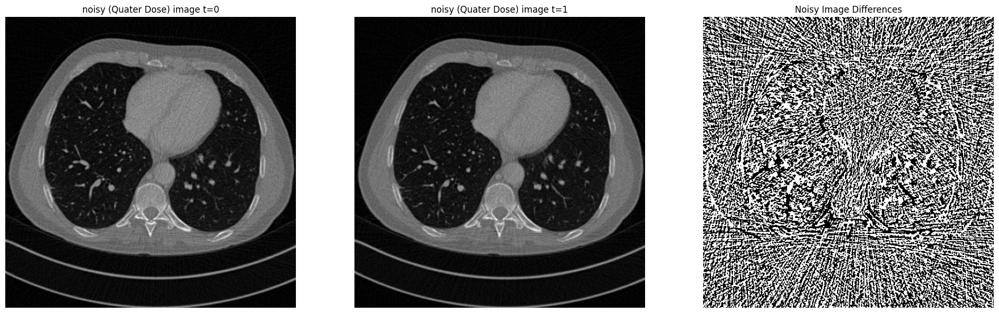

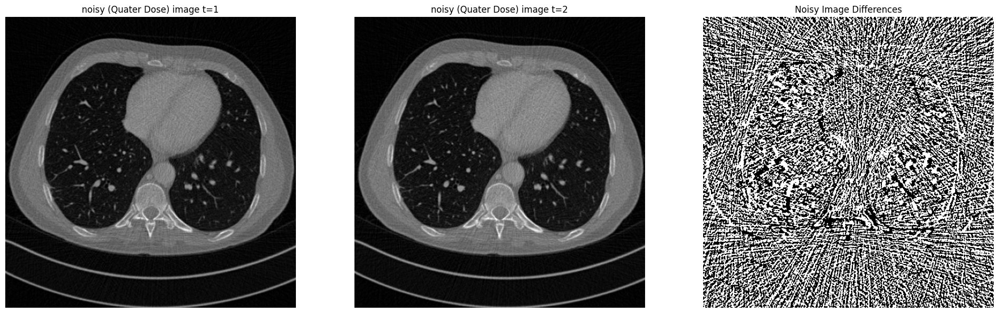

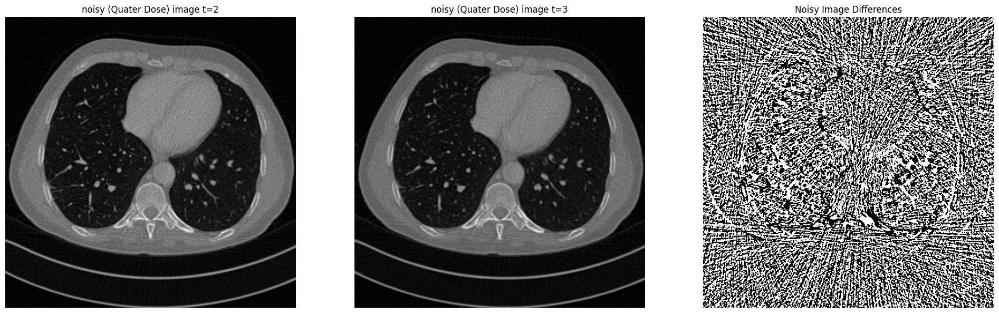

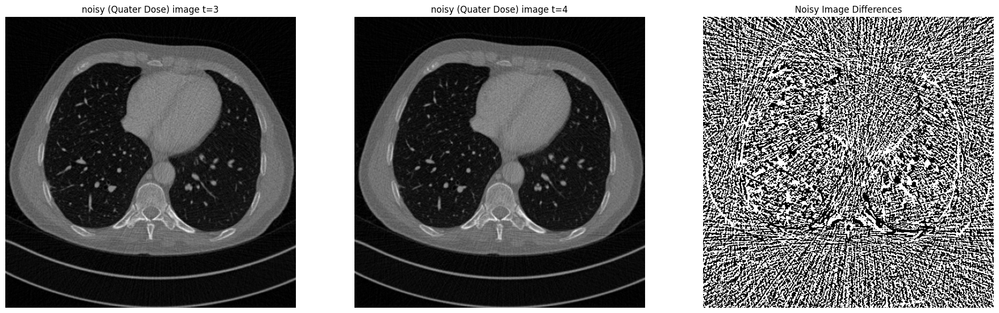

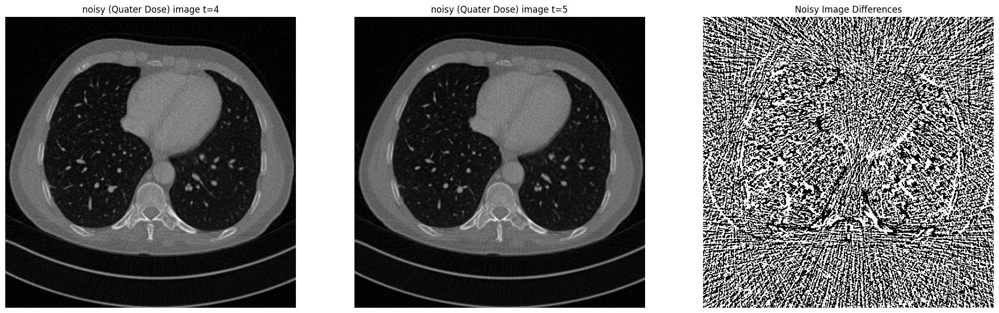

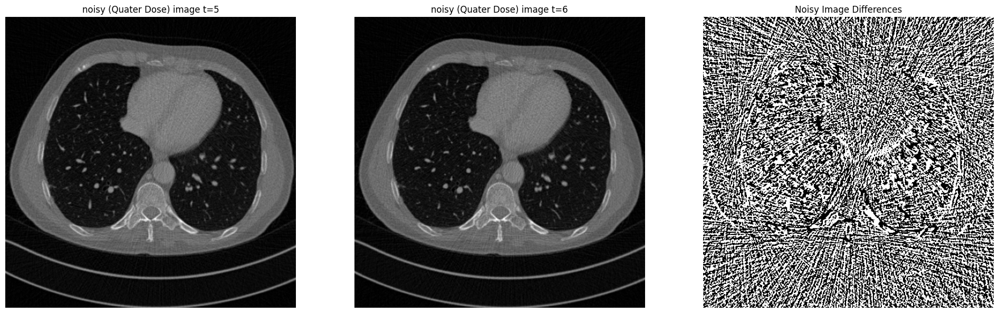

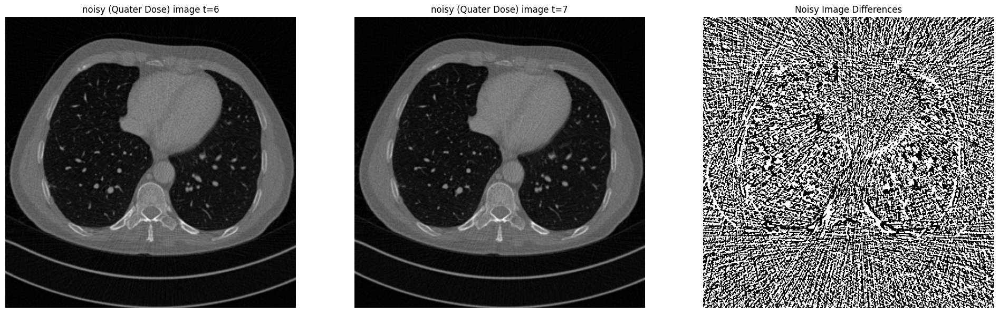

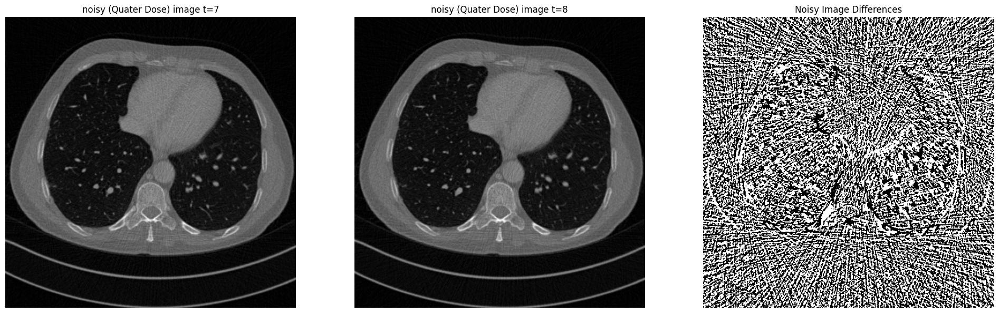

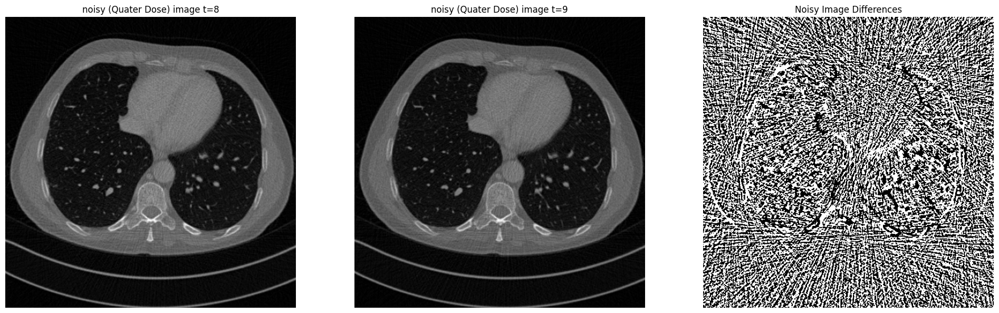

In [13]:
for i in range(9):
    noisy_image_0 = read_image(training_filepaths_x[i])
    clean_image_0 = read_image(training_filepaths_y[i])
    
    noisy_image_1 = read_image(training_filepaths_x[i + 1])
    clean_image_1 = read_image(training_filepaths_y[i + 1])
    
    fig, axs = plt.subplots(1, 3, figsize=(20, 6))  # Adjust figsize as needed
    
    # Display noisy_image_0
    axs[0].set_title('noisy (Quater Dose) image t=' + str(i))
    axs[0].imshow(noisy_image_0, cmap='gray')
    axs[0].axis('off')  # Turn off axis labels
    
    # Display clean_image_1
    axs[1].set_title('noisy (Quater Dose) image t=' + str(i + 1))
    axs[1].imshow(noisy_image_1, cmap='gray')
    axs[1].axis('off')  # Turn off axis labels
    
    axs[2].set_title('Noisy Image Differences')
    axs[2].imshow(noisy_image_1 - noisy_image_0, cmap='gray')
    axs[2].axis('off')  # Turn off axis labels
    
    plt.tight_layout()
    plt.show()


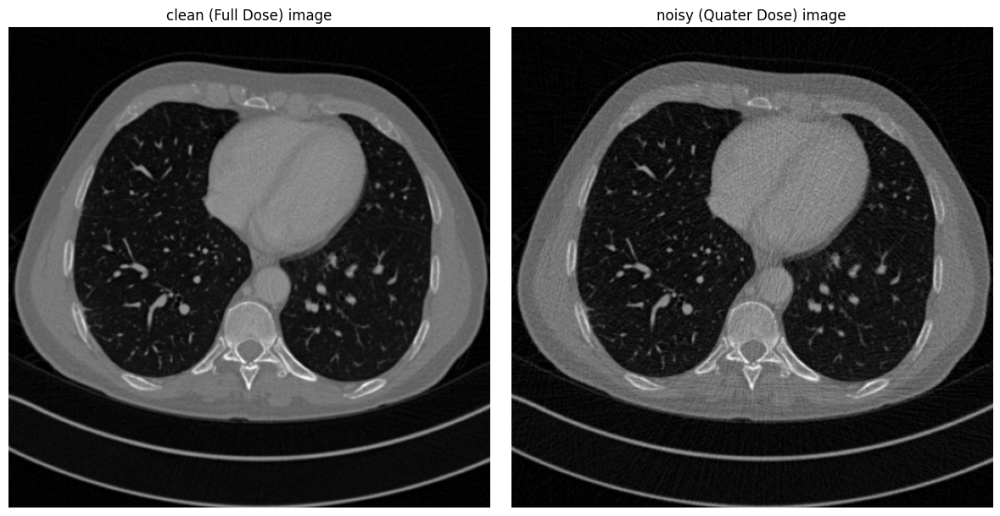

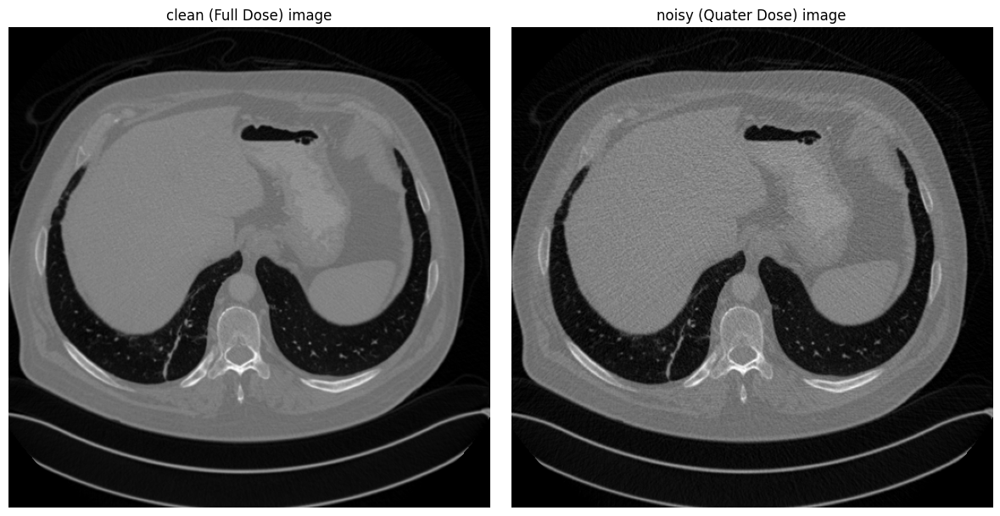

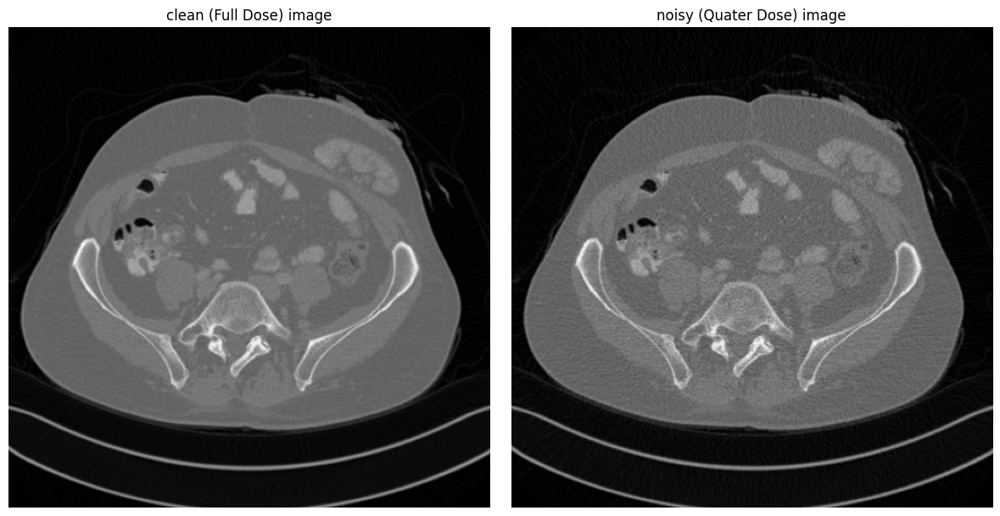

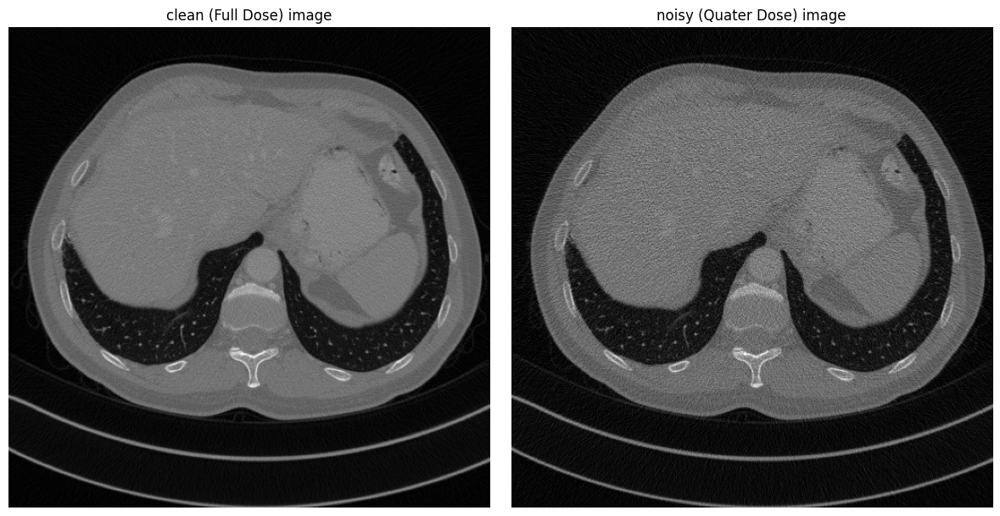

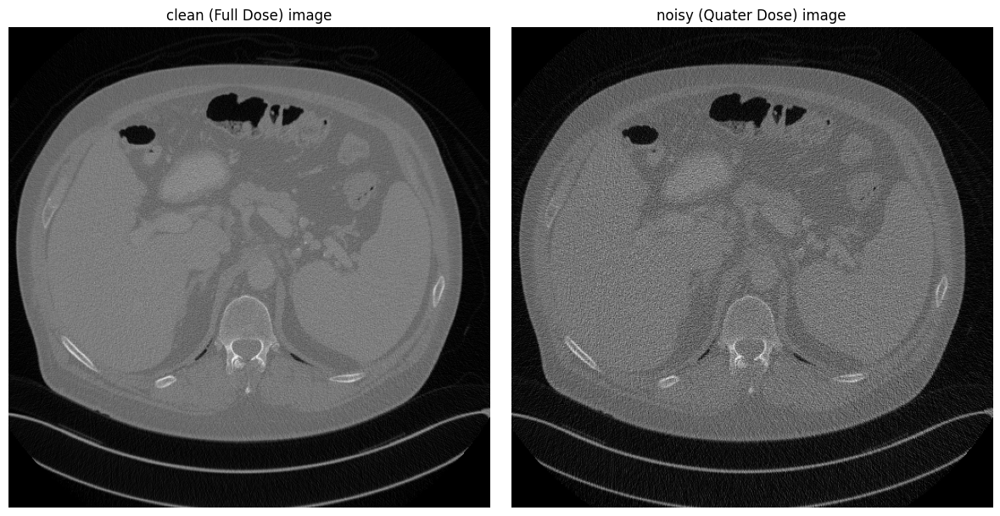

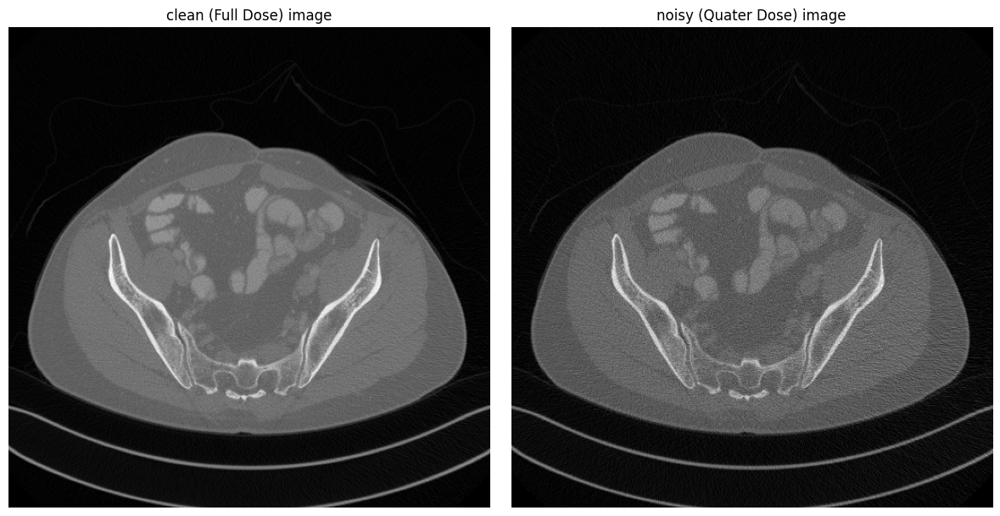

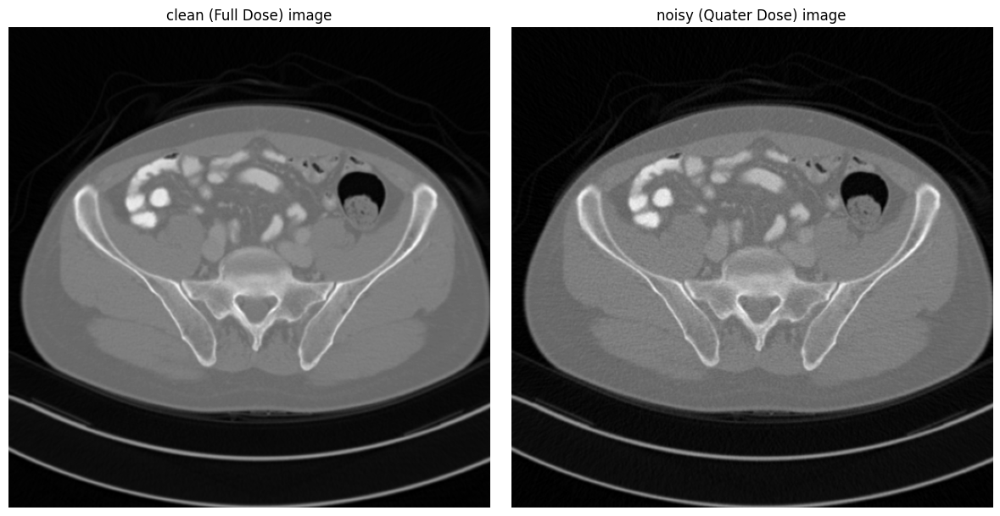

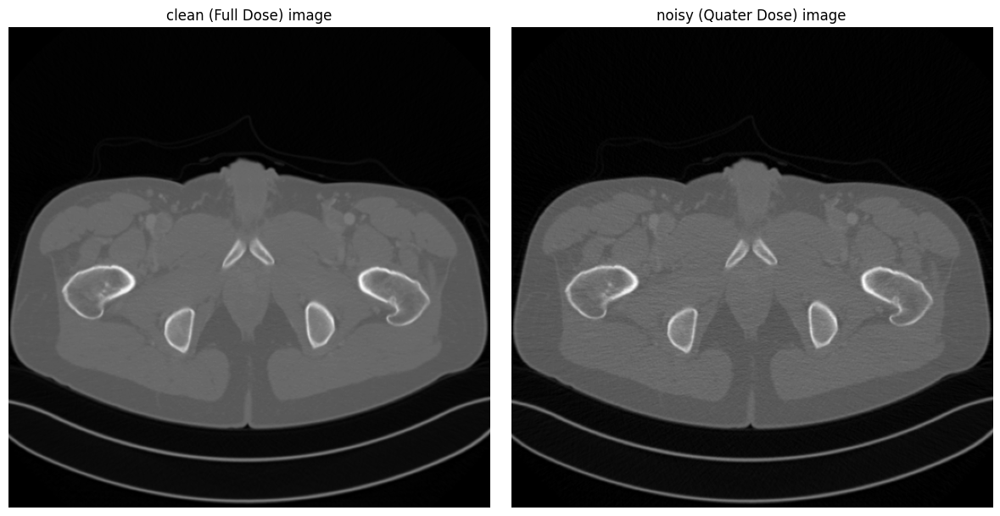

In [14]:
for i in range(0, 16000, 2000):
    noisy_image = read_image(training_filepaths_x[i])
    clean_image = read_image(training_filepaths_y[i])
    
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    
    axs[0].set_title('clean (Full Dose) image')
    axs[0].imshow(clean_image, cmap='gray')
    axs[0].axis('off')  # Turn off axis labels
    
    axs[1].set_title('noisy (Quater Dose) image')
    axs[1].imshow(noisy_image, cmap='gray')
    axs[1].axis('off')  # Turn off axis labels
    
    plt.tight_layout()
    
    plt.show()